In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier, plot_tree
from pandas.api.types import CategoricalDtype
from sklearn.metrics import accuracy_score, classification_report, ConfusionMatrixDisplay

In [ ]:
ds = pd.read_csv('./preprocessed_mean.csv')

In [ ]:
ds.describe()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
count,20000.000000,20000.000000,20000.000000,2.000000e+04,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,46.367100,0.340399,0.545596,2.592875e+05,0.561824,0.253581,0.189415,-10.674001,0.102728,118.201869,0.398924
std,16.554067,0.380775,0.204310,1.338799e+05,0.296470,0.365628,0.157082,7.892410,0.109077,28.904267,0.252902
min,0.000000,0.000001,0.060000,1.550900e+04,0.000792,0.000000,0.015700,-47.046000,0.022400,34.347000,0.000000
25%,34.000000,0.018400,0.400750,1.978385e+05,0.343000,0.000000,0.094700,-13.274000,0.038500,95.447500,0.180000
50%,50.000000,0.141000,0.566000,2.367330e+05,0.629000,0.002170,0.122000,-7.624500,0.051200,120.154137,0.373000
75%,58.000000,0.726000,0.704000,2.886735e+05,0.805000,0.605250,0.235000,-5.333750,0.116000,137.382250,0.590000
max,96.000000,0.996000,0.986000,4.830606e+06,0.999000,0.994000,0.991000,1.585000,0.932000,220.041000,0.992000


In [ ]:
#Separamos los datos de entrenamiento de los de test y asignamos a cada variable su tipo

categorical = []
numerical = []

for cat in ds.columns:
  if (ds[cat].dtype == object and cat != 'music_genre'): categorical.append(cat)
  else: numerical.append(cat)

ds = pd.get_dummies(ds, columns=categorical)

X = ds.drop(labels='music_genre', axis = 1, inplace=False)
Y = ds['music_genre']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, shuffle=True, random_state=33)

In [ ]:
#Entrenamos un Decision Tree con los parametros por defecto como Baseline
dtree = DecisionTreeClassifier()
dtree.fit(X_train,Y_train)

dtree.score(X_train,Y_train)

0.9986875

In [ ]:
dtree.score(X_test,Y_test)

0.8395

In [ ]:
fig = plt.figure(dpi = 500)

plot_tree(dtree, filled=True,rounded=True,feature_names=ds.columns);
plt.show()

In [ ]:
#Exploramos una serie de hyperparametros con GridSearchCV para intentar reducir la complejidad del arbol

#max_f = [3,5,7,10,13,15,17,19,21,23,25]
#spl = ['best', 'random']
crit = ['gini', 'entropy']
min_s_s = [2,4,5,6,7,8,9,10,15,20,30,]
max_d = [4,5,6,7,8,9,10,11,12,15,20,30,40,50,70,90,120,150]
min_s_l = [1,2,4,5,6,7,8,9,10,15,20,30]

params = {'criterion':crit, 'min_samples_split' : min_s_s, 'max_depth' : max_d, 'min_samples_leaf' : min_s_l}

dtree = DecisionTreeClassifier()
clf = GridSearchCV(dtree, params)

clf.fit(X_train, Y_train)

GridSearchCV(estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [4, 5, 6, 7, 8, 9, 10, 11, 12, 15, 20, 30,
                                       40, 50, 70, 90, 120, 150],
                         'min_samples_leaf': [1, 2, 4, 5, 6, 7, 8, 9, 10, 15,
                                              20, 30],
                         'min_samples_split': [2, 4, 5, 6, 7, 8, 9, 10, 15, 20,
                                               30]})

In [ ]:
bp = clf.best_params_
bp

In [ ]:
#Entrenamos el con los mejores hyperparametros obtenidos
dtree = DecisionTreeClassifier(criterion='entropy', max_depth=8, min_samples_leaf=6, min_samples_split=15)
dtree.fit(X_train,Y_train)
dtree.score(X_train,Y_train)

0.8971875

In [ ]:
dtree.score(X_test,Y_test)

0.8715

In [ ]:
print(classification_report(Y_test,dtree.predict(X_test)))

              precision    recall  f1-score   support

   Classical       0.95      0.91      0.93       955
  Electronic       0.88      0.85      0.86      1057
     Hip-Hop       0.85      0.87      0.86       995
        Rock       0.82      0.86      0.84       993

    accuracy                           0.87      4000
   macro avg       0.87      0.87      0.87      4000
weighted avg       0.87      0.87      0.87      4000



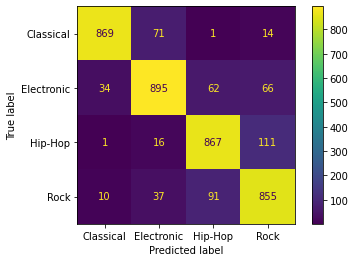

In [ ]:
ConfusionMatrixDisplay.from_predictions(Y_test,dtree.predict(X_test))

In [ ]:
fig = plt.figure(dpi = 500)

plot_tree(dtree, filled=True, rounded=True, feature_names=ds.columns);
plt.show()

In [ ]:
# plot the tree with just 4 levels to make an analysis
# explain that the deeper the tree goes, the easier it is to overfit the data
fig = plt.figure(dpi = 500)

plot_tree(dtree, filled=True, rounded=True, max_depth=4, fontsize=9, feature_names=ds.columns)
plt.show()


# predict a single row, analyze the path it takes
#dtree.predict(X_test[x])

# analyze feature importance





In [ ]:
# analyze the decisions taken at each level:

plt.plot(df.level_1, ds.target, 'o')